# Simulating on NVIDIA Graphics Card with CUDA

In [1]:
CODE_ROOT = pwd() * "/"

"/Users/robertstrauss/Desktop/MPAS_Ocean_Julia/"

In [2]:
include(CODE_ROOT * "mode_init/MPAS_Ocean.jl")

include(CODE_ROOT * "mode_forward/time_steppers.jl")

include(CODE_ROOT * "visualization.jl")

include(CODE_ROOT * "mode_init/MPAS_Ocean_CUDA.jl")

include(CODE_ROOT * "mode_init/exactsolutions.jl")

DetermineInertiaGravityWaveExactSurfaceElevation (generic function with 1 method)

In [6]:
CUDA.memory_status()

Effective GPU memory usage: 9.55% (774.562 MiB/7.921 GiB)
CUDA allocator usage: 0 bytes
Memory pool usage: 0 bytes (0 bytes allocated, 0 bytes cached)


In [7]:
const MAX_THREADS_PER_BLOCK = CUDA.attribute(
        CUDA.CuDevice(0), CUDA.DEVICE_ATTRIBUTE_MAX_THREADS_PER_BLOCK,
)

1024

# Load Mesh From File

In [3]:
mpasOcean = MPAS_Ocean(CODE_ROOT * "InertiaGravityWaveMesh",
                "base_mesh.nc", "mesh.nc", periodicity="Periodic"
)
mpasOcean.nCells

10000

# Define Initial Condition

In [4]:
etaHat, f0, kX, kY, omega = inertiaGravityWaveParams(mpasOcean, 3, 1, 1e-2)
inertiaGravityExactSolution!(mpasOcean, etaHat, f0, kX, kY, omega, 0.0) # could also do gaussianInit!

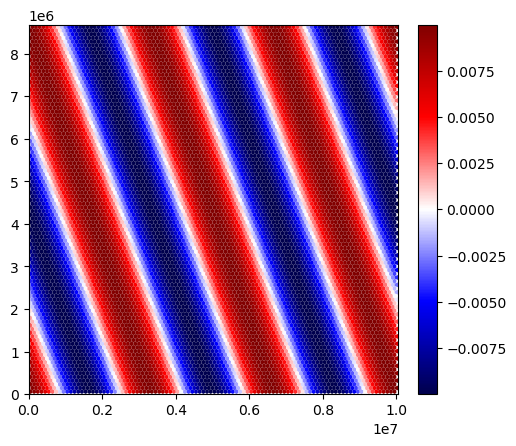

In [7]:
fig, ax, cbar, col = heatMapMesh(mpasOcean, mpasOcean.layerThickness[1,:]-mpasOcean.bottomDepth)
display(fig)

# Simulate Wave on GPU

In [9]:
period = 2*pi/(omega*mpasOcean.dt) # number of timesteps per cycle of wave

69.5570898543736

In [ ]:
# simulate and record nFrames snapshots of the SSH
nFrames = 60

steps = Int(floor(nFrames/period))

sshOverTime = zeros(nFrames, mpasOcean.nCells)

mpasOceanCuda = MPAS_Ocean_CUDA(mpasOcean)

for i in 1:nFrames
    for j in 1:steps
        forward_backward_step_cuda!(mpasOceanCuda)
    end
    sshOverTime[i,:] = sum(Array(mpasOceanCuda.layerThickness), dims=1) - Array(mpasOcean.bottomDepth)
end

## Animate Simulation

In [18]:
using PyCall, PyPlot

animation = pyimport("matplotlib.animation")
ipydisplay = pyimport("IPython.display")

PyObject <module 'IPython.display' from '/home/rrs/anaconda3/envs/MPAS_Ocean/lib/python3.8/site-packages/IPython/display.py'>

In [28]:
cMax = maximum(abs.(sshOverTime))

fig, ax, _, col = heatMapMesh(mpasOcean, sshOverTime[1,:], cMin=-cMax, cMax=cMax)

function nextFrame(i)
    col.set_array(sshOverTime[i+1,:])
end

anim = animation.FuncAnimation(fig, nextFrame, frames=nFrames)

PyObject <matplotlib.animation.FuncAnimation object at 0x7fdd008c8c40>

In [29]:
ipydisplay.HTML(anim.to_jshtml())

Animation size has reached 21215824 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


PyObject <IPython.core.display.HTML object>